In [3]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import sys
sys.path.append('..')
from src.visualization import slides

# New pairs (9 stimuli) pitted against each other

In [2]:
def find_closest_value(array, value):
    return array[np.abs(array - value).argmin()]
    

def normalize(array, min_value, max_value, new_min, new_max):
    return (array - min_value) / (max_value - min_value) * (new_max - new_min) + new_min

slope = 2
logistic = lambda x: 1 / (1 + np.exp(-slope*x))
pp1 = np.round(logistic(np.linspace(-1, 1, 9)),2)
pp2 = np.round(logistic(np.linspace(-1, 1, 12)),2)

ppp = []

for p in normalize(pp1, pp1.min(), pp1.max(), .25, .75):
    closest = find_closest_value(normalize(pp2, pp2.min(), pp2.max(), .25, .75), p)
    corresponding_p = pp2[np.abs(normalize(pp2, pp2.min(), pp2.max(), .25, .75) - p).argmin()]
    ppp.append(corresponding_p)
    print(f'Closest value to {p:.2f} in pp2: {closest:.2f} with delta = {np.abs(p - closest):.2f}, with corresponding p={corresponding_p:.2f}')

ppp = np.array(ppp)
ppp

Closest value to 0.25 in pp2: 0.25 with delta = 0.00, with corresponding p=0.12
Closest value to 0.29 in pp2: 0.28 with delta = 0.01, with corresponding p=0.16
Closest value to 0.35 in pp2: 0.36 with delta = 0.01, with corresponding p=0.29
Closest value to 0.42 in pp2: 0.41 with delta = 0.01, with corresponding p=0.37
Closest value to 0.50 in pp2: 0.47 with delta = 0.03, with corresponding p=0.45
Closest value to 0.58 in pp2: 0.59 with delta = 0.01, with corresponding p=0.63
Closest value to 0.65 in pp2: 0.64 with delta = 0.01, with corresponding p=0.71
Closest value to 0.71 in pp2: 0.72 with delta = 0.01, with corresponding p=0.84
Closest value to 0.75 in pp2: 0.75 with delta = 0.00, with corresponding p=0.88


array([0.12, 0.16, 0.29, 0.37, 0.45, 0.63, 0.71, 0.84, 0.88])

# BLACK AND WHITE

[0.12 0.16 0.29 0.45 0.71 0.84 0.88]


C:\Users\basil\AppData\Local\Temp\ipykernel_19048\1587509671.py:8: RuntimeWarning: overflow encountered in exp
  sigmoid = lambda x, beta, lims: lims[0] + np.diff(lims) / (1 + np.exp(-beta * x))


0.12 0.17 0.15
0.18 0.23 0.21
0.27 0.28 0.29
0.38 0.41 0.39
0.5 0.52 0.5
0.62 0.5900000000000001 0.61
0.73 0.72 0.71
0.82 0.77 0.79
0.88 0.83 0.85


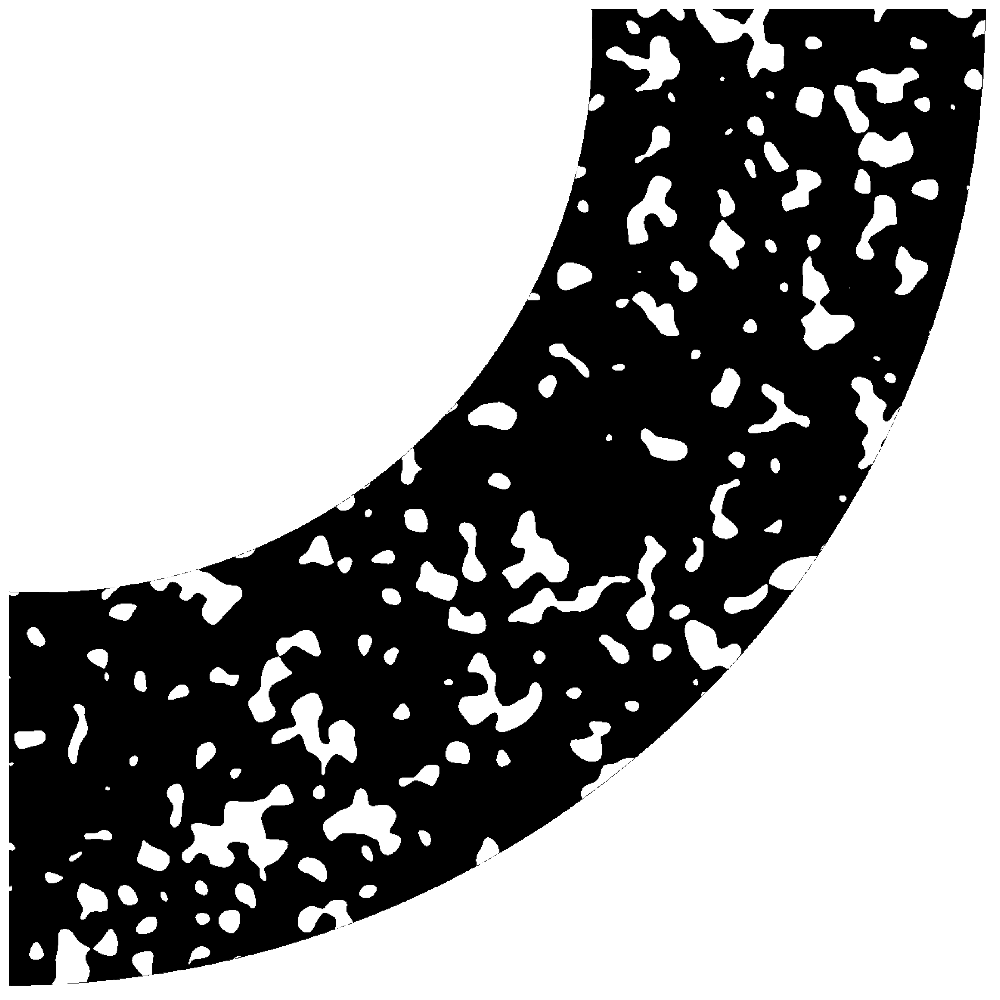

In [29]:
from scipy.optimize import root_scalar, fsolve
from scipy.ndimage import gaussian_filter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def create_circular_aperture(diameter=10):
    sigmoid = lambda x, beta, lims: lims[0] + np.diff(lims) / (1 + np.exp(-beta * x))

    diameter = int(np.floor(diameter / 2) * 2)
    x, y = np.meshgrid(np.arange(1, diameter + 1) - (diameter + 1) / 2, np.arange(1, diameter + 1) - (diameter + 1) / 2)

    patch = sigmoid(np.sqrt(x ** 2 + y ** 2) - diameter / 2, np.log(99), [1, 0])

    return patch


def remove_uncovered_area(matrix, circle_radius=10, circle_center=(300, 300)):
    """
    Remove the area not covered by the circle from the input matrix.

    Args:
    - matrix: Input binary matrix.
    - circle_radius: Radius of the circle.
    - circle_center: Coordinates of the center of the circle.

    Returns:
    - result_matrix: Output matrix after removing the uncovered area.
    """
    # Create a binary matrix representing the entire area
    binary_matrix = np.ones_like(matrix, dtype=bool)
    
    # Generate the circle matrix
    circle_matrix = generate_circle(circle_radius, circle_center, matrix.shape)
    
    # Subtract the circle matrix from the binary matrix
    uncovered_area = np.logical_xor(binary_matrix, circle_matrix) #binary_matrix - circle_matrix
    
    # Remove the uncovered area from the input matrix
    result_matrix = np.copy(matrix)
    result_matrix[uncovered_area] = np.nan
    
    return result_matrix

def cut_upper_half(matrix):
    """
    Cut the upper half of the matrix.

    Args:
    - matrix: Input binary matrix.

    Returns:
    - half_matrix: Output matrix after cutting the upper half.
    """
    half_matrix = np.copy(matrix)
    half_matrix[:half_matrix.shape[0]//2, :] = np.nan
    return half_matrix

def cut_left_half(matrix):
    """
    Cut the left half of the matrix.

    Args:
    - matrix: Input binary matrix.

    Returns:
    - half_matrix: Output matrix after cutting the left half.
    """
    half_matrix = np.copy(matrix)
    half_matrix[:, :half_matrix.shape[1]//2] = np.nan
    return half_matrix

def subtract_circle(matrix, smaller_radius, center):
    """
    Subtract a smaller circle from the input matrix.

    Args:
    - matrix: Input binary matrix.
    - smaller_radius: Radius of the smaller circle.
    - center: Coordinates of the center of the smaller circle.

    Returns:
    - result_matrix: Output matrix after subtracting the smaller circle.
    """
    # Create a grid of coordinates
    x, y = np.meshgrid(np.arange(matrix.shape[1]), np.arange(matrix.shape[0]))
    
    # Calculate distances from each point to the center
    distances = (x - center[1])**2 + (y - center[0])**2
    
    # Set pixels within the smaller circle radius to 0
    result_matrix = np.copy(matrix)
    result_matrix[distances <= smaller_radius**2] = np.nan
    
    return result_matrix

def gen_cue(exp_ratio=0.5, nstd=5, fstd=10, imsize=600, colors=[[0, 0, 0], [1, 1, 1]]):
    p = create_circular_aperture(imsize)
    non_patch = np.ones_like(p)  # Create a matrix of ones with the same shape as patch
    p[p != non_patch] = np.nan  # Set NaN values where the patch is not present
    ROI = p.ravel() > 0.5

    img_noise = nstd * np.random.randn(imsize, imsize) + exp_ratio
    img_filt = gaussian_filter(img_noise, sigma=fstd)

    fun = lambda t,_ : np.mean(img_filt.ravel()[ROI] > t) - exp_ratio

    theta = root_scalar(fun, args=(exp_ratio, ), method='bisect', bracket=[0, 5]).root

    img_bin = np.zeros_like(img_filt)
    img_bin[img_filt > theta] = 1
    img_bin[img_filt < theta] = 0
    img = np.minimum(img_bin, p)

    # npatch = np.ones_like(p>0.5)
    # img[img!=npatch] = np.nan

    prp = np.mean(img.ravel()[ROI] > 0.5)
    
    return img, prp


# default seed is 0
np.random.seed(0)
# seed 1 was used for 0.37 and 0.63
# np.random.seed(1)

scale = 4
smaller_circle_radius = 183 * scale
smaller_circle_center = np.array([335, 335]) * scale

slope = 2
logistic = lambda x: 1 / (1 + np.exp(-slope * (x)))
x = logistic(np.linspace(-1, 1, 9))
y = np.round(normalize(x, x.min(), x.max(), 0., 0.85), 2)
x = np.round(x, 2)
y = {x: y for x, y in zip(x, y)}

plt.figure(figsize=(15, 15), dpi=300)
from matplotlib.colors import ListedColormap
# Define the colors
yellow = [255, 220, 51, 255] 
blue = [24, 115, 211, 255]
black = [0, 0, 0, 255]
white = [255, 255, 255, 255]

# Create a colormap with blue and yellow
colors = [black, white]
cmap = ListedColormap(colors)

# remove .37 and .63
# ppp1 = ppp[ppp != 0.37]
# ppp2 = ppp1[ppp1 != 0.63]
pp = enumerate(x)
pp2 = enumerate((0.37, 0.63))

count = 0 
mirror = {}

print(ppp2)
for i, p in pp:
    
        
    count += 1
    # plt.subplot(3, 4, count)

    # print('exp_ratio:', y[p])
    img1, prp = gen_cue(exp_ratio=y[p], imsize=650 * scale, colors=colors)
    img = cut_upper_half(img1)
    img = cut_left_half(img)
    img = subtract_circle(img, smaller_circle_radius, smaller_circle_center)

    # drop the upper half of the matrix
    img = img[img.shape[0]//2:, :]
    # drop the left half of the matrix
    img = img[:, img.shape[1]//2:]

    # create a 3D matrix with the same shape as img, where the first layer is the img, and the other two are the colors
    # where 1 use color 1, where 0 use color 0
    new_img = np.zeros((img.shape[0], img.shape[1], 4))
    # new_img[:] = np.nan

    new_img[img == 0] = np.array(colors[1])
    new_img[img == 1] = np.array(colors[0])


    if p <= .5:
        mirror[p] = img[:]
    else:
        p_r = np.round(1 - p,2)
        new_img[mirror[p_r] == 1] = np.array(colors[1])
        new_img[mirror[p_r] == 0] = np.array(colors[0])

    new_img = new_img.astype(np.float32)
    new_img/=255

    plt.imshow(new_img)
    # plt.colorbar()
    plt.axis('off')  # Turn off axis
    # var = np.round(1-p,2)
    plt.savefig(f'../outputs/black_and_white/{p}.png', bbox_inches='tight', pad_inches=0, transparent=True)

    # plt.show()
    # print(var)
    # print(p)
    # print(prp)
    if p > .5:
        # print(mirror.keys())
        img = mirror[p_r]

    img_without_nan = img[~np.isnan(img)]
    prp = np.round(np.mean(img_without_nan.ravel() > 0.5), 2)
    if p > .5:
        prp = 1 - prp
    print(p, prp, y[p])
    # plt.title(f'p(destroy)={p:.2f}')
    # break

# plt.show()
# plt.suptitle('PYTHON')
# plt.tight_layout()

In [22]:
y

{0.12: 0.25,
 0.18: 0.29,
 0.27: 0.35,
 0.38: 0.42,
 0.5: 0.5,
 0.62: 0.58,
 0.73: 0.65,
 0.82: 0.71,
 0.88: 0.75}

# BLUE - YELLOW

C:\Users\basil\AppData\Local\Temp\ipykernel_30216\377497744.py:8: RuntimeWarning: overflow encountered in exp
  sigmoid = lambda x, beta, lims: lims[0] + np.diff(lims) / (1 + np.exp(-beta * x))


0.12 0.17 0.15
0.18 0.23 0.21
0.27 0.28 0.29
0.38 0.41 0.39
0.5 0.52 0.5
0.62 0.5900000000000001 0.61
0.73 0.72 0.71
0.82 0.77 0.79
0.88 0.83 0.85


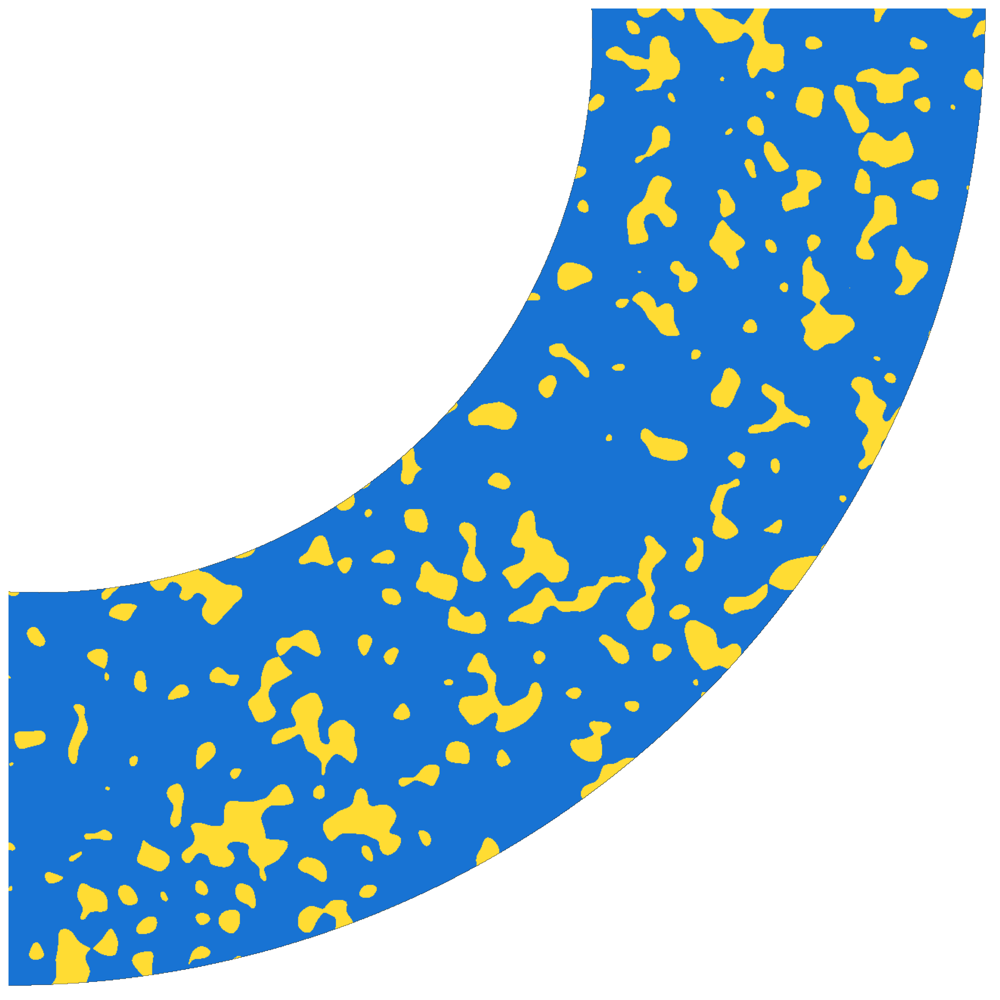

In [21]:
from scipy.optimize import root_scalar, fsolve
from scipy.ndimage import gaussian_filter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def create_circular_aperture(diameter=10):
    sigmoid = lambda x, beta, lims: lims[0] + np.diff(lims) / (1 + np.exp(-beta * x))

    diameter = int(np.floor(diameter / 2) * 2)
    x, y = np.meshgrid(np.arange(1, diameter + 1) - (diameter + 1) / 2, np.arange(1, diameter + 1) - (diameter + 1) / 2)

    patch = sigmoid(np.sqrt(x ** 2 + y ** 2) - diameter / 2, np.log(99), [1, 0])

    return patch


def remove_uncovered_area(matrix, circle_radius=10, circle_center=(300, 300)):
    """
    Remove the area not covered by the circle from the input matrix.

    Args:
    - matrix: Input binary matrix.
    - circle_radius: Radius of the circle.
    - circle_center: Coordinates of the center of the circle.

    Returns:
    - result_matrix: Output matrix after removing the uncovered area.
    """
    # Create a binary matrix representing the entire area
    binary_matrix = np.ones_like(matrix, dtype=bool)
    
    # Generate the circle matrix
    circle_matrix = generate_circle(circle_radius, circle_center, matrix.shape)
    
    # Subtract the circle matrix from the binary matrix
    uncovered_area = np.logical_xor(binary_matrix, circle_matrix) #binary_matrix - circle_matrix
    
    # Remove the uncovered area from the input matrix
    result_matrix = np.copy(matrix)
    result_matrix[uncovered_area] = np.nan
    
    return result_matrix

def cut_upper_half(matrix):
    """
    Cut the upper half of the matrix.

    Args:
    - matrix: Input binary matrix.

    Returns:
    - half_matrix: Output matrix after cutting the upper half.
    """
    half_matrix = np.copy(matrix)
    half_matrix[:half_matrix.shape[0]//2, :] = np.nan
    return half_matrix

def cut_left_half(matrix):
    """
    Cut the left half of the matrix.

    Args:
    - matrix: Input binary matrix.

    Returns:
    - half_matrix: Output matrix after cutting the left half.
    """
    half_matrix = np.copy(matrix)
    half_matrix[:, :half_matrix.shape[1]//2] = np.nan
    return half_matrix

def subtract_circle(matrix, smaller_radius, center):
    """
    Subtract a smaller circle from the input matrix.

    Args:
    - matrix: Input binary matrix.
    - smaller_radius: Radius of the smaller circle.
    - center: Coordinates of the center of the smaller circle.

    Returns:
    - result_matrix: Output matrix after subtracting the smaller circle.
    """
    # Create a grid of coordinates
    x, y = np.meshgrid(np.arange(matrix.shape[1]), np.arange(matrix.shape[0]))
    
    # Calculate distances from each point to the center
    distances = (x - center[1])**2 + (y - center[0])**2
    
    # Set pixels within the smaller circle radius to 0
    result_matrix = np.copy(matrix)
    result_matrix[distances <= smaller_radius**2] = np.nan
    
    return result_matrix

def gen_cue(exp_ratio=0.5, nstd=5, fstd=10, imsize=600, colors=[[0, 0, 0], [1, 1, 1]]):
    p = create_circular_aperture(imsize)
    non_patch = np.ones_like(p)  # Create a matrix of ones with the same shape as patch
    p[p != non_patch] = np.nan  # Set NaN values where the patch is not present
    ROI = p.ravel() > 0.5

    img_noise = nstd * np.random.randn(imsize, imsize) + exp_ratio
    img_filt = gaussian_filter(img_noise, sigma=fstd)

    fun = lambda t,_ : np.mean(img_filt.ravel()[ROI] > t) - exp_ratio

    theta = root_scalar(fun, args=(exp_ratio, ), method='bisect', bracket=[0, 5]).root

    img_bin = np.zeros_like(img_filt)
    img_bin[img_filt > theta] = 1
    img_bin[img_filt < theta] = 0
    img = np.minimum(img_bin, p)

    # npatch = np.ones_like(p>0.5)
    # img[img!=npatch] = np.nan

    prp = np.mean(img.ravel()[ROI] > 0.5)
    
    return img, prp


# default seed is 0
np.random.seed(0)
# seed 1 was used for 0.37 and 0.63
# np.random.seed(1)

scale = 4
smaller_circle_radius = 183 * scale
smaller_circle_center = np.array([335, 335]) * scale

slope = 2
logistic = lambda x: 1 / (1 + np.exp(-slope * (x)))
x = logistic(np.linspace(-1, 1, 9))
y = np.round(normalize(x, x.min(), x.max(), 0.15, 0.85), 2)
x = np.round(x, 2)
y = {x: y for x, y in zip(x, y)}

plt.figure(figsize=(15, 15), dpi=300)
from matplotlib.colors import ListedColormap
# Define the colors
yellow = [255, 220, 51, 255] 
blue = [24, 115, 211, 255]
black = [0, 0, 0, 255]
white = [255, 255, 255, 255]

# Create a colormap with blue and yellow
colors = [blue, yellow]
cmap = ListedColormap(colors)

# remove .37 and .63
# ppp1 = ppp[ppp != 0.37]
# ppp2 = ppp1[ppp1 != 0.63]
pp = enumerate(x)
pp2 = enumerate((0.37, 0.63))

count = 0 
mirror = {}

# print(ppp)
for i, p in pp:
    
        
    count += 1
    # plt.subplot(3, 4, count)

    # print('exp_ratio:', y[p])
    img1, prp = gen_cue(exp_ratio=y[p], imsize=650 * scale, colors=colors)
    img = cut_upper_half(img1)
    img = cut_left_half(img)
    img = subtract_circle(img, smaller_circle_radius, smaller_circle_center)

    # drop the upper half of the matrix
    img = img[img.shape[0]//2:, :]
    # drop the left half of the matrix
    img = img[:, img.shape[1]//2:]

    # create a 3D matrix with the same shape as img, where the first layer is the img, and the other two are the colors
    # where 1 use color 1, where 0 use color 0
    new_img = np.zeros((img.shape[0], img.shape[1], 4))
    # new_img[:] = np.nan

    new_img[img == 0] = np.array(colors[1])
    new_img[img == 1] = np.array(colors[0])


    if p <= .5:
        mirror[p] = img[:]
    else:
        p_r = np.round(1 - p,2)
        new_img[mirror[p_r] == 1] = np.array(colors[1])
        new_img[mirror[p_r] == 0] = np.array(colors[0])

    new_img = new_img.astype(np.float32)
    new_img/=255

    plt.imshow(new_img)
    # plt.colorbar()
    plt.axis('off')  # Turn off axis
    # var = np.round(1-p,2)
    plt.savefig(f'../outputs/new_cues/{p}.png', bbox_inches='tight', pad_inches=0, transparent=True)

    # plt.show()
    # print(var)
    # print(p)
    # print(prp)
    if p > .5:
        # print(mirror.keys())
        img = mirror[p_r]

    img_without_nan = img[~np.isnan(img)]
    prp = np.round(np.mean(img_without_nan.ravel() > 0.5), 2)
    if p > .5:
        prp = 1 - prp
    print(p, prp, y[p])
    # plt.title(f'p(destroy)={p:.2f}')
    # break

# plt.show()
# plt.suptitle('PYTHON')
# plt.tight_layout()

In [3]:
import numpy as np


# load the images
import cv2
# and check that there is more black in current image than the previous
for p in ppp:
    # img = plt.imread(f'../outputs/black_and_white/{p}.png')
    img = cv2.imread(f'../outputs/cues/{p}.png', cv2.IMREAD_UNCHANGED)
    # Separate the alpha channel
    alpha_channel = img[:, :, 3]
    print(np.unique(alpha_channel))
    # Set transparent pixels to NaN
    image_with_nan = img.copy().astype(np.float32)
    image_with_nan[alpha_channel == 0] = np.nan
    # sum of nan
    print(np.sum(np.isnan(image_with_nan)))

    # Merge the modified alpha channel back with the original image
    # image_with_nan_merged = cv2.merge((image_with_nan[:, :, 0], image_with_nan[:, :, 1], image_with_nan[:, :, 2], alpha_channel))

    # print(img)
    # (thresh, img) = cv2.threshold(img, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    # img = img[img.shape[0]//2:, img.shape[1]//2:]
    # img = img[:, :, :3]
    # img = img[~np.isnan(img).any(axis=2)]
    prp = np.round(np.mean(image_with_nan[~np.isnan(image_with_nan)].ravel() < 127), 2)
    print(p, prp)
    # break
    # plt.imshow(img)

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244 245 24

ValueError: num must be an integer with 1 <= num <= 8, not 9

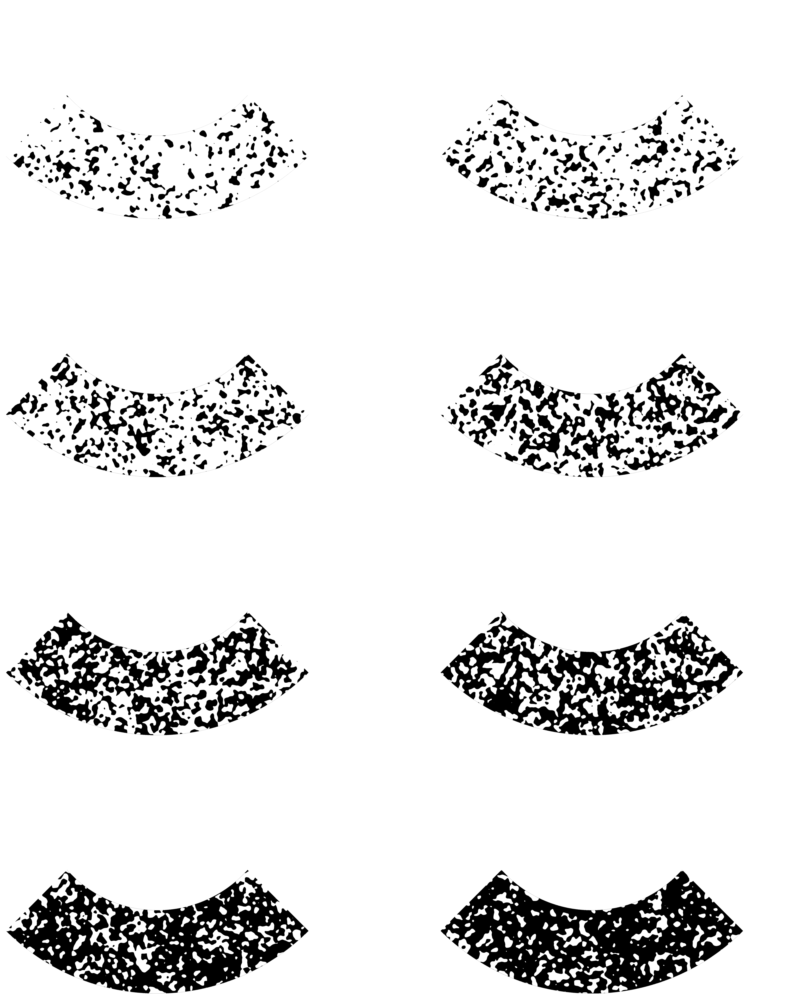

In [16]:
import matplotlib.pyplot as plt
import matplotlib.transforms as transforms
import numpy as np

plt.rcParams.update({
    "figure.facecolor": (0.0, 0.0, 0.0, 0.0),  # RGB + alpha
    "axes.facecolor":  (0.0, 0.0, 0.0, 0.0),  # RGB + alpha
})

def normalize(array, min_value, max_value, new_min, new_max):
    return (array - min_value) / (max_value - min_value) * (new_max - new_min) + new_min

# Plot settings
count = 0
to_black_and_white = True
path = '../outputs/black_and_white/'
slope = 2
logistic = lambda x: 1 / (1 + np.exp(-slope * (x)))
x = logistic(np.linspace(-1, 1, 9))
y = np.round(normalize(x, x.min(), x.max(), 0.15, 0.85), 2)
x = np.round(x, 2)

# Set up figure and subplots
plt.figure(figsize=(20, 25), dpi=300)
for p in x:
    count += 1
    plt.subplot(5, 2, count)
    img = plt.imread(f'{path}{p}.png')

    # Apply transformation: rotate 45 degrees clockwise
    tr = transforms.Affine2D().rotate_deg(45)
    
    # Plot the image, ensuring it fits within the subplot
    plt.imshow(img, transform=tr + plt.gca().transData, clip_on=False)
    
    # Hide the axis and set the title
    plt.axis('off')
    # plt.title(f'p(destroy)={p:.2f}', fontsize=30)

# Apply tight layout to avoid overlapping elements
plt.tight_layout()
# plt.show()
# show with transparent background
# 



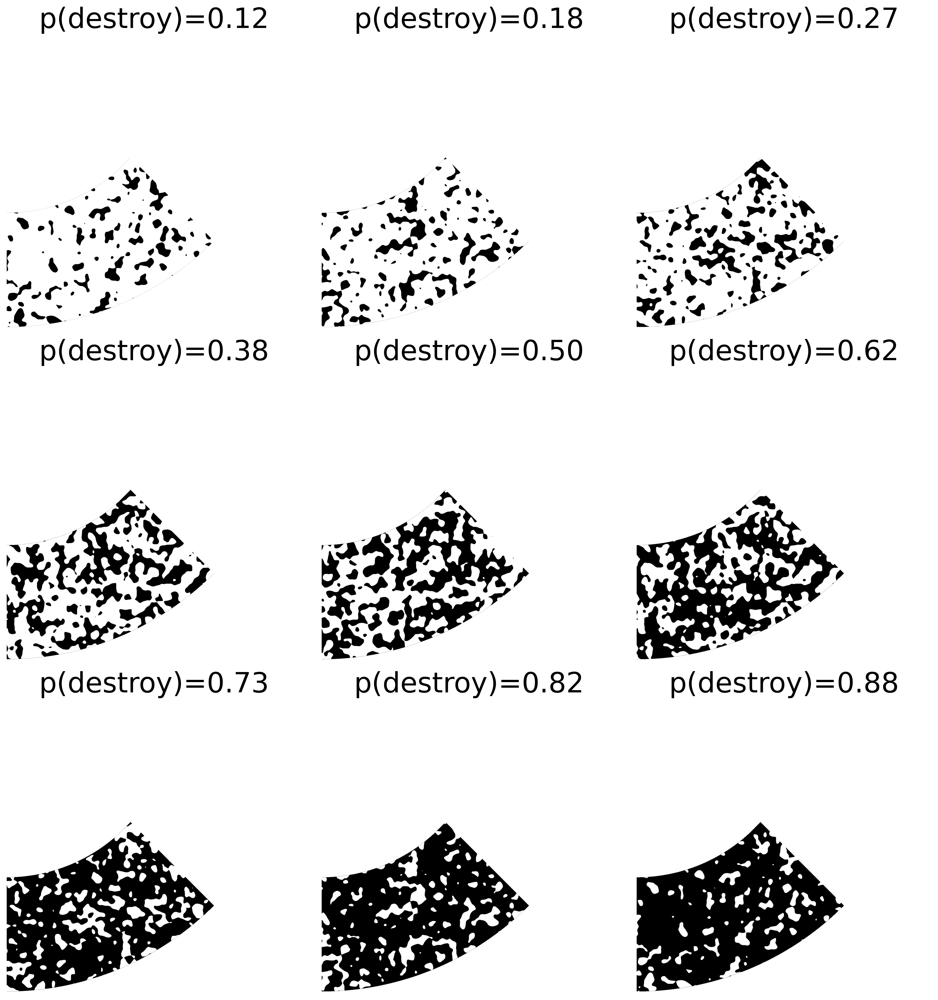

In [8]:
import matplotlib.pyplot as plt
import matplotlib.transforms as transforms
import numpy as np

def normalize(array, min_value, max_value, new_min, new_max):
    return (array - min_value) / (max_value - min_value) * (new_max - new_min) + new_min
# plot all the images
count = 0

to_black_and_white = True
path = '../outputs/black_and_white/'
slope = 2
logistic = lambda x: 1 / (1 + np.exp(-slope * (x)))
x = logistic(np.linspace(-1, 1, 9))
y = np.round(normalize(x, x.min(), x.max(), 0.15, 0.85), 2)
x = np.round(x, 2)
plt.figure(figsize=(15, 15), dpi=300)
for p in x:
    count += 1
    plt.subplot(3, 3, count)
    img = plt.imread(f'{path}{p}.png')
    # if to_black_and_white:
        # 
        #
    tr = transforms.Affine2D().rotate_deg(45)
    plt.imshow(img, transform=tr + plt.gca().transData)
    # image rotate 45 degrees clockwise
    # plt.rotate(45)
    plt.axis('off')
    plt.tight_layout()
    plt.title(f'p(destroy)={p:.2f}', fontsize=30)
    
plt.tight_layout()
# plt.show()
# slides.add('black_and_white.pptx')

In [ ]:
test = 1

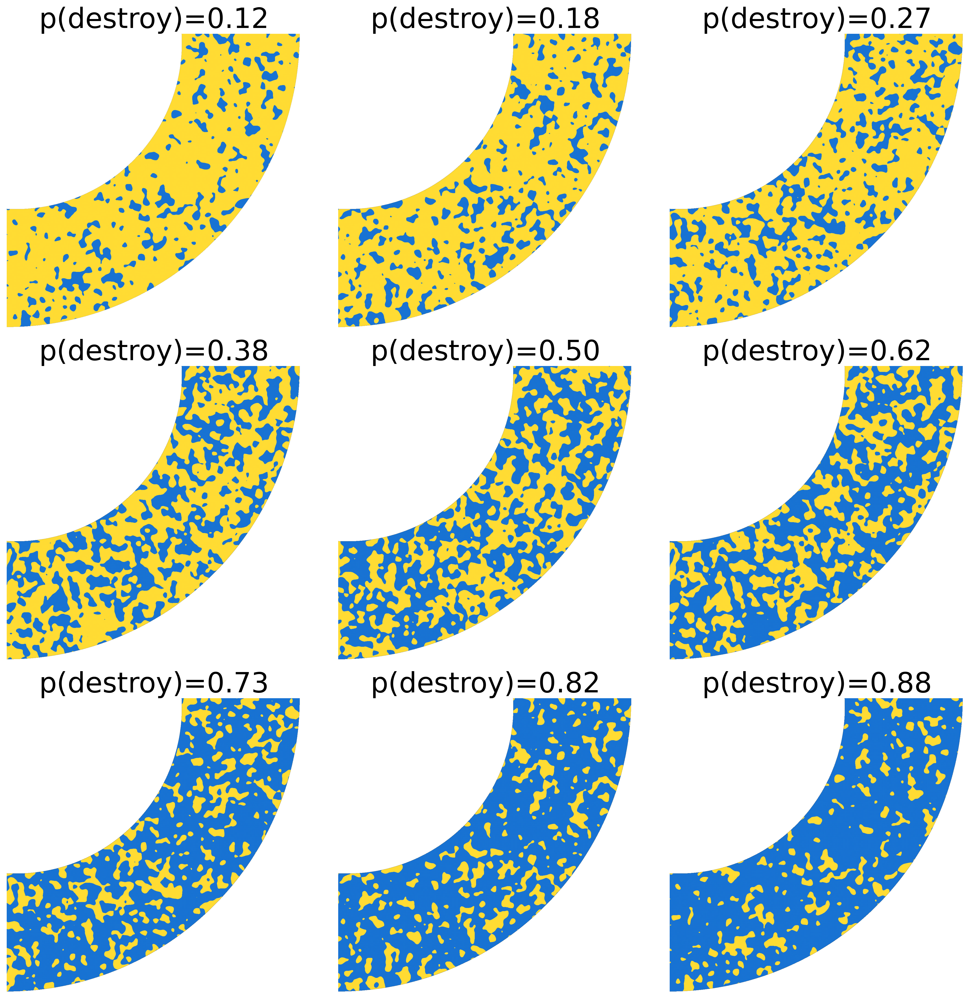

In [22]:
import matplotlib.pyplot as plt

# plot all the images
count = 0
slope = 2

logistic = lambda x: 1 / (1 + np.exp(-slope * (x)))
x = logistic(np.linspace(-1, 1, 9))
y = np.round(normalize(x, x.min(), x.max(), 0., 0.85), 2)
x = np.round(x, 2)
y = {x: y for x, y in zip(x, y)}

to_black_and_white = True
path = '../outputs/new_cues/'

plt.figure(figsize=(15, 15), dpi=300)
for p in x:
    count += 1
    plt.subplot(3, 3, count)
    img = plt.imread(f'{path}{p}.png')
    # if to_black_and_white:
        # 
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'p(destroy)={p:.2f}', fontsize=30)
    
plt.tight_layout()
# plt.show()
# slides.add('yellow_blue.pptx')

In [56]:
# create a string for each pair like new Vector2(x1f, x2f)
s = ''
for i,j in enumerate(pairs):
    s+= f'new Vector2({j[0]}f, {j[1]}f)'
    if i < len(pairs) - 1:
        s+=',\n'

print(s)

# compute number of lines in s
# len(s.split('\n'))



new Vector2(0.12f, 0.18f),
new Vector2(0.12f, 0.27f),
new Vector2(0.12f, 0.38f),
new Vector2(0.12f, 0.5f),
new Vector2(0.12f, 0.62f),
new Vector2(0.12f, 0.73f),
new Vector2(0.12f, 0.82f),
new Vector2(0.12f, 0.88f),
new Vector2(0.18f, 0.12f),
new Vector2(0.18f, 0.27f),
new Vector2(0.18f, 0.38f),
new Vector2(0.18f, 0.5f),
new Vector2(0.18f, 0.62f),
new Vector2(0.18f, 0.73f),
new Vector2(0.18f, 0.82f),
new Vector2(0.18f, 0.88f),
new Vector2(0.27f, 0.12f),
new Vector2(0.27f, 0.18f),
new Vector2(0.27f, 0.38f),
new Vector2(0.27f, 0.5f),
new Vector2(0.27f, 0.62f),
new Vector2(0.27f, 0.73f),
new Vector2(0.27f, 0.82f),
new Vector2(0.27f, 0.88f),
new Vector2(0.38f, 0.12f),
new Vector2(0.38f, 0.18f),
new Vector2(0.38f, 0.27f),
new Vector2(0.38f, 0.5f),
new Vector2(0.38f, 0.62f),
new Vector2(0.38f, 0.73f),
new Vector2(0.38f, 0.82f),
new Vector2(0.38f, 0.88f),
new Vector2(0.5f, 0.12f),
new Vector2(0.5f, 0.18f),
new Vector2(0.5f, 0.27f),
new Vector2(0.5f, 0.38f),
new Vector2(0.5f, 0.62f),
new Vector

In [14]:
import numpy as np
logistic = lambda x: 1 / (1 + np.exp(-2 * (x)))
pp = np.round(logistic(np.linspace(-1, 1, 9)),2)
pairs = np.array([(i, j) for i in pp for j in pp if i != j])
np.unique(pairs[:, 1])

array([0.12, 0.18, 0.27, 0.38, 0.5 , 0.62, 0.73, 0.82, 0.88])

C:\Users\basil\AppData\Local\Temp\ipykernel_19048\2685608959.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 5))


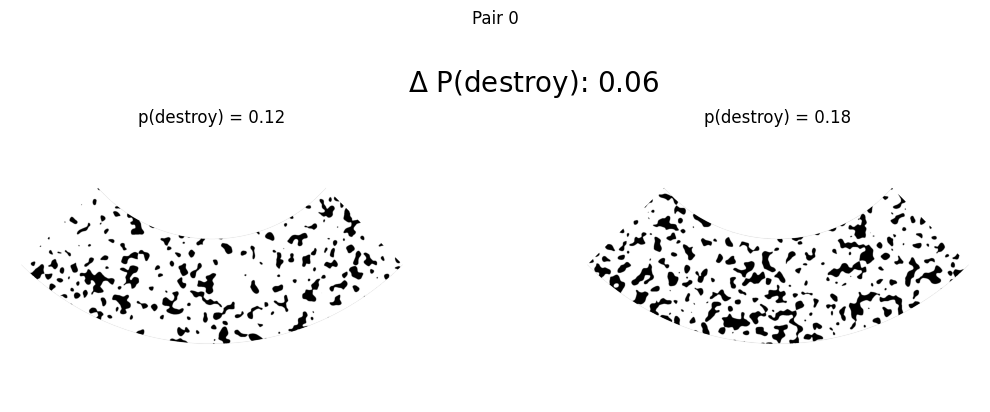

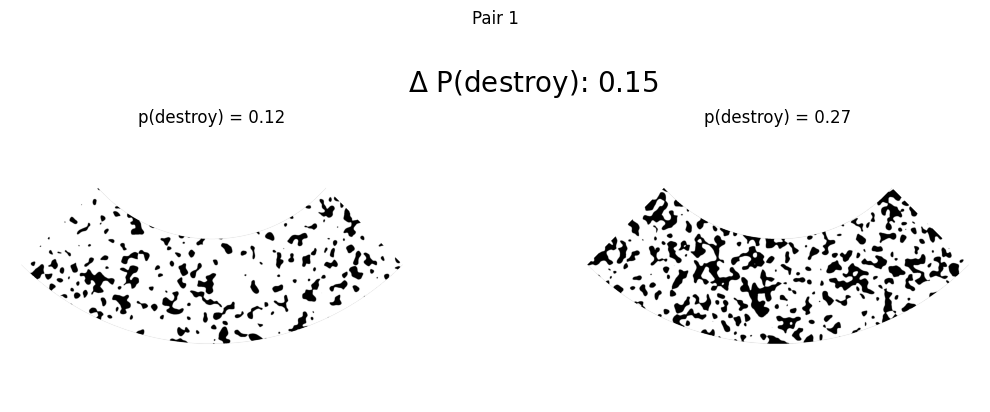

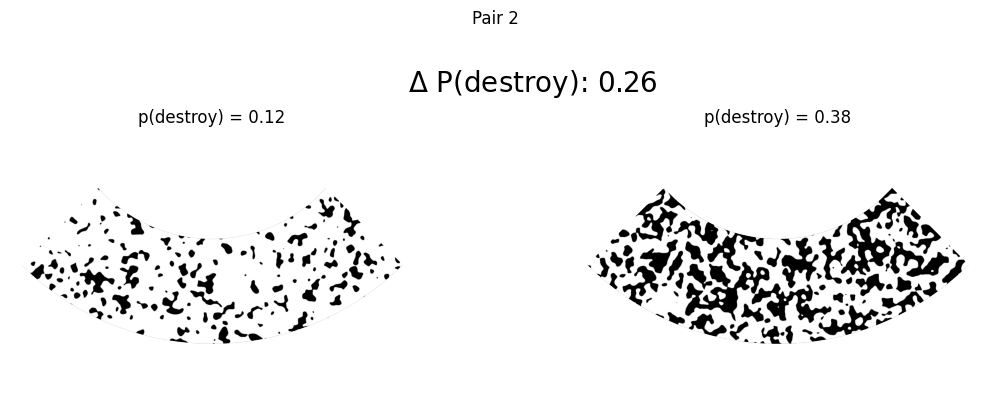

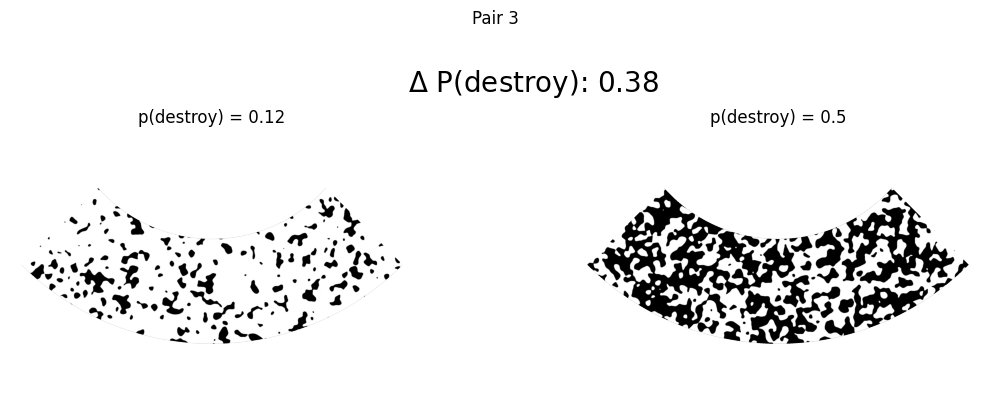

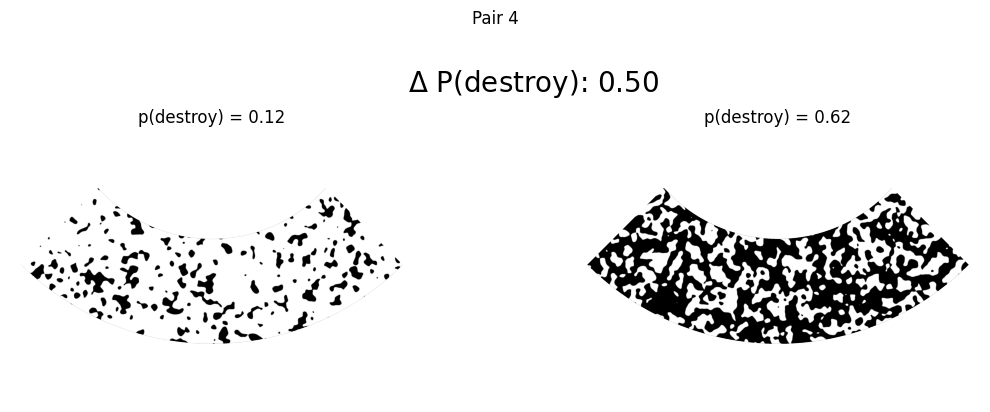

...

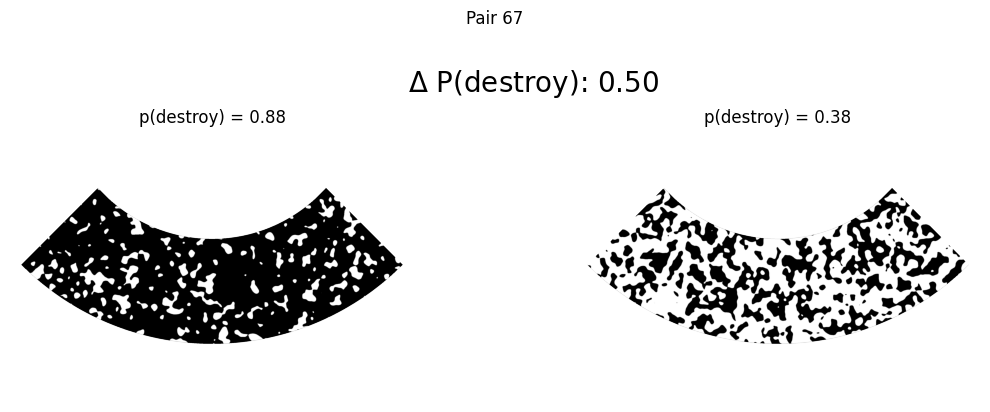

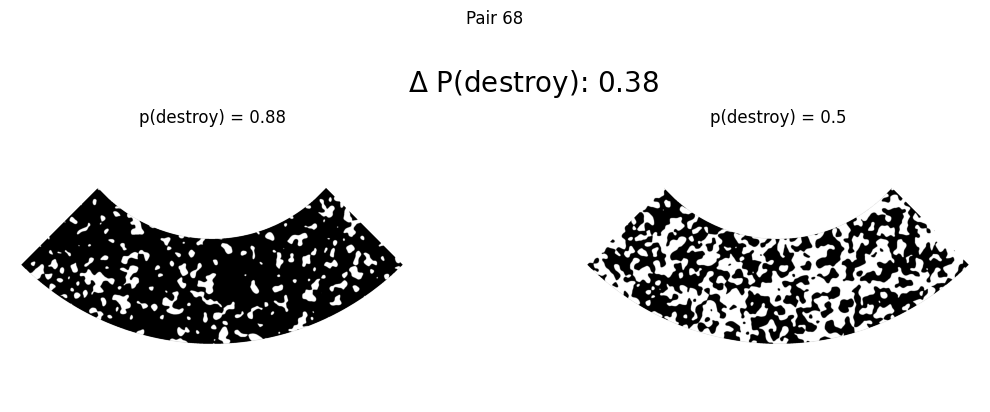

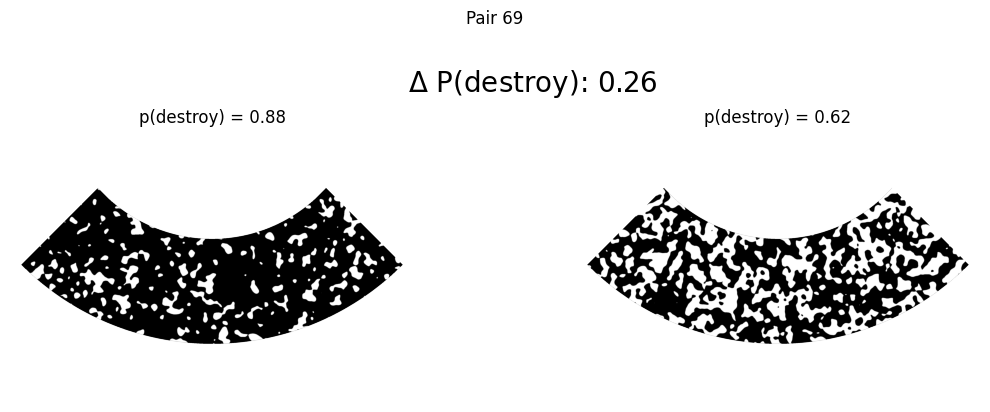

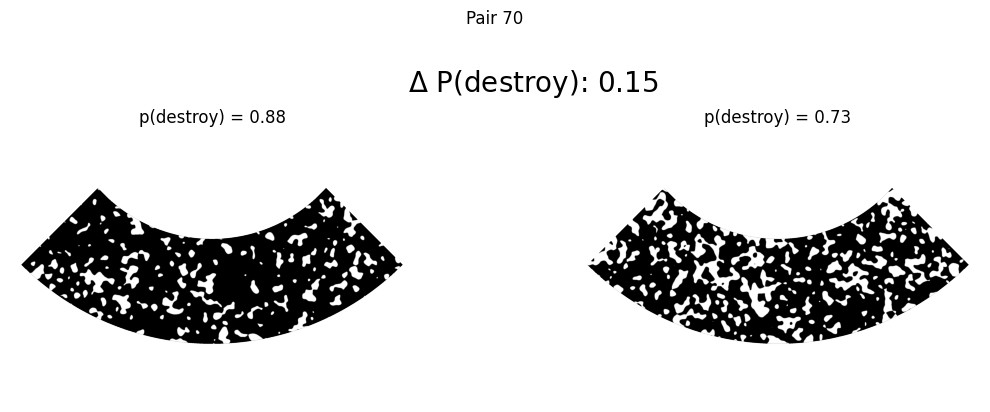

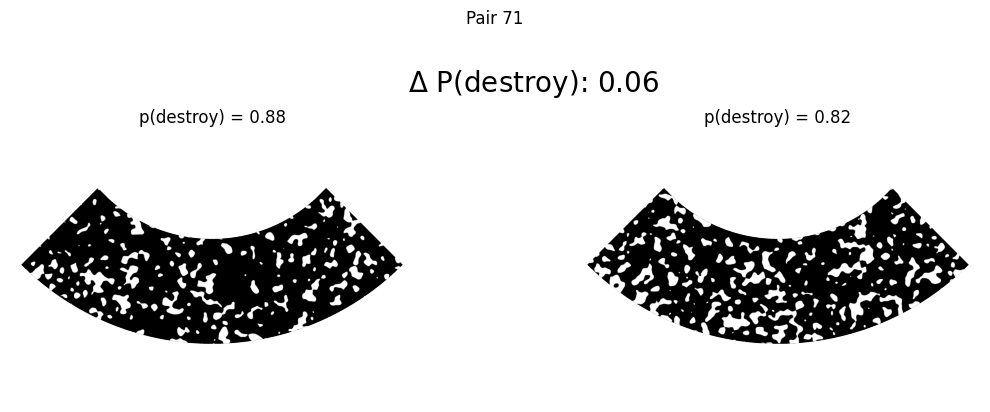

In [34]:
from matplotlib import transforms
import matplotlib.pyplot as plt
import numpy as np
# plot pairs (side by side) in the same plot using cues/value.png
# i.e. 0.78.png, 0.88.png, 0.12.png, 0.22.png, etc.
pp = np.round(logistic(np.linspace(-1, 1, 9)),2)
pairs = [(i, j) for i in pp for j in pp if i != j]

path = '../outputs/black_and_white/'
for i, (p1,  p2) in enumerate(pairs[:]):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    image = plt.imread(f'{path}{p1}.png')
    # Define the rotation transformation with translation to center
    tr = (transforms.Affine2D()
      .translate(-image.shape[1] / 2, -image.shape[0] / 2)  # translate to center
      .rotate_deg(45)  # rotate
      .translate(image.shape[1] / 2, image.shape[0] / 2))  # translate back
    transformed_image = plt.imshow(image, transform=tr+plt.gca().transData)
    # Adjust plot limits
    # plt.xlim(0, image.shape[0])
    # plt.ylim(0, image.shape[1])
    extent = transformed_image.get_extent()
    
    plt.xlim(extent[0]-850, extent[1]+850)
    plt.title('p(destroy) = ' + str(p1))
    # Get the extent of the transformed image

    plt.axis('off')

    plt.subplot(122)

    image = plt.imread(f'{path}{p2}.png')
    # Define the rotation transformation with translation to center
    tr = (transforms.Affine2D()
      .translate(-image.shape[1] / 2, -image.shape[0] / 2)  # translate to center
      .rotate_deg(45)  # rotate
      .translate(image.shape[1] / 2, image.shape[0] / 2))  # translate back
    transformed_image = plt.imshow(image, transform=tr+plt.gca().transData)
    # Adjust plot limits
    plt.xlim(-500, image.shape[0]+500)
    plt.ylim(0, image.shape[1])
    
    extent = transformed_image.get_extent()

    # Adjust plot limits
    plt.xlim(extent[0]-850, extent[1]+850)
    plt.ylim(extent[2], extent[3])

    plt.axis('off')
    plt.suptitle(f'Pair {i}')
    plt.title('p(destroy) = ' + str(p2))
    plt.text(-3000, -500, f'$\\Delta$ P(destroy): {np.abs(p1 - p2):.2f}', fontsize=20)
    
    # plt.draw()
    slides.add('black_and_white.pptx')


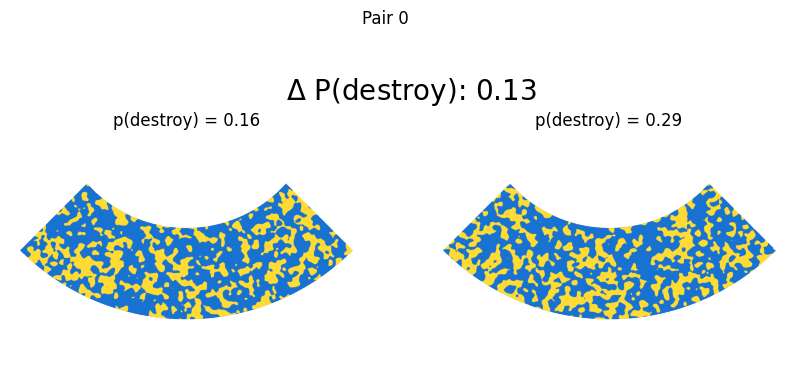

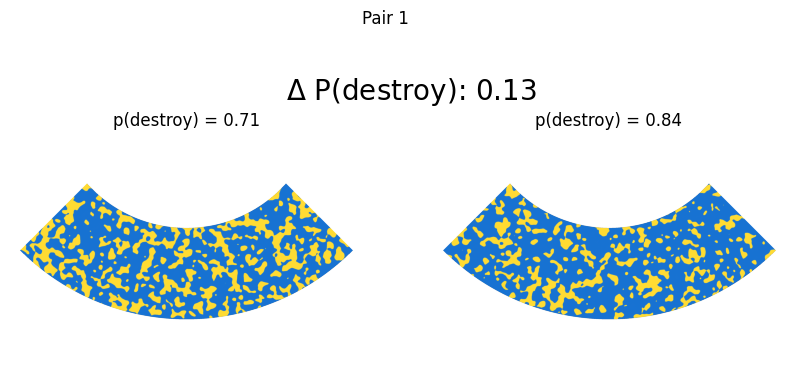

In [ ]:
from matplotlib import transforms
# plot pairs (side by side) in the same plot using cues/value.png
# i.e. 0.78.png, 0.88.png, 0.12.png, 0.22.png, etc.

pairs = [
  [0.16, 0.29],
  [0.71, 0.84],
  # [0.63, 0.78],
  # [0.55, 0.71],
  # [0.45, 0.63],
  # [0.37, 0.55],
  # [0.29, 0.45],
  # [0.22, 0.37],
]
# sort pairs by delta
pairs = np.array(pairs)
pairs = pairs[np.argsort(pairs[:, 1] - pairs[:, 0])]

for i, (p1,  p2) in enumerate(pairs):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    image = plt.imread(f'cues/{p1}.png')
    # Define the rotation transformation with translation to center
    tr = (transforms.Affine2D()
      .translate(-image.shape[1] / 2, -image.shape[0] / 2)  # translate to center
      .rotate_deg(45)  # rotate
      .translate(image.shape[1] / 2, image.shape[0] / 2))  # translate back
    transformed_image = plt.imshow(image, transform=tr+plt.gca().transData)
    # Adjust plot limits
    # plt.xlim(0, image.shape[0])
    # plt.ylim(0, image.shape[1])
    extent = transformed_image.get_extent()
    
    plt.xlim(extent[0]-850, extent[1]+850)
    plt.title('p(destroy) = ' + str(p1))
    # Get the extent of the transformed image

    plt.axis('off')

    plt.subplot(122)

    image = plt.imread(f'cues/{p2}.png')
    # Define the rotation transformation with translation to center
    tr = (transforms.Affine2D()
      .translate(-image.shape[1] / 2, -image.shape[0] / 2)  # translate to center
      .rotate_deg(45)  # rotate
      .translate(image.shape[1] / 2, image.shape[0] / 2))  # translate back
    transformed_image = plt.imshow(image, transform=tr+plt.gca().transData)
    # Adjust plot limits
    plt.xlim(-500, image.shape[0]+500)
    plt.ylim(0, image.shape[1])
    
    extent = transformed_image.get_extent()

    # Adjust plot limits
    plt.xlim(extent[0]-850, extent[1]+850)
    plt.ylim(extent[2], extent[3])

    plt.axis('off')
    plt.suptitle(f'Pair {i}')
    plt.title('p(destroy) = ' + str(p2))
    plt.text(-3000, -500, f'$\\Delta$ P(destroy): {np.abs(p1 - p2):.2f}', fontsize=20)
    
    # plt.draw()
    plt.show()


KeyboardInterrupt: 

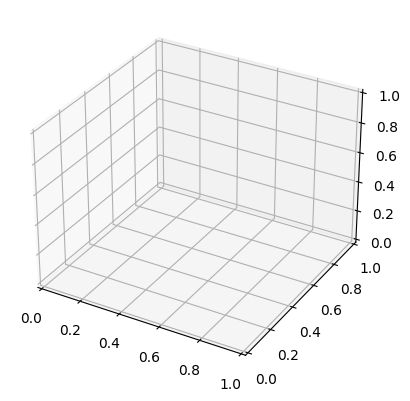

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Load your PNG image
image = plt.imread('cues/0.12.png')

# Create a meshgrid for x and y
x = np.linspace(0, 1, image.shape[1])
y = np.linspace(0, 1, image.shape[0])
X, Y = np.meshgrid(x, y)

# Z dimension for stacking the image
Z = np.zeros_like(X)

# Create a figure and 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the image as a surface
ax.plot_surface(X, Y, Z, facecolors=image, rstride=1, cstride=1, shade=False)

# Hide the axes
ax.axis('off')

# Show the plot
plt.show()

In [ ]:
import cv2
import numpy as np

# Load the circle image
circle_img = cv2.imread("cues/0.12.png", cv2.IMREAD_UNCHANGED)
# Get dimensions of the image
height, width = circle_img.shape[:2]


# Define the thickness of the disc
thickness = 10  # Adjust as needed

# Create an empty canvas for the 3D disc
disc = np.zeros((height, width, 4, thickness), dtype=np.uint8)

# Stack the circle images along the z-axis
for i in range(thickness):
    disc[:, :, :, i] = circle_img[:, :, :]


# Display or save the 3D disc
# For displaying
cv2.imshow('3D Disc', disc)
# cv2.waitKey(100)

# For saving
# for i in range(thickness):
#     cv2.imwrite(f'disc_{i}.png', disc[:, :, i])

# Close OpenCV windows
# cv2.destroyAllWindows()


error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\highgui\src\window_w32.cpp:124: error: (-215:Assertion failed) bmi && width >= 0 && height >= 0 && (bpp == 8 || bpp == 24 || bpp == 32) in function 'FillBitmapInfo'


In [ ]:
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np

# Load the circle image
circle_img = cv2.imread("cues/0.12.png", cv2.IMREAD_UNCHANGED)

# Get dimensions of the image
height, width, channels = circle_img.shape

# Define the thickness of the disc
thickness = 300  # Adjust as needed

# Create an empty canvas for the 3D disc
disc = np.zeros((height, width, channels * thickness), dtype=np.uint8)

# Stack the circle images along the z-axis
for i in range(thickness):
    disc[:, :, i * channels:(i + 1) * channels] = circle_img


def write_obj(vertices, output_obj_path='output.obj'):
    with open(output_obj_path, 'w') as obj_file:
        for vertex in vertices:
            obj_file.write(f'v {vertex[0]} {vertex[1]} {vertex[2]}\n')

    print(f'OBJ file saved to {output_obj_path}')

write_obj(disc, 'disc.obj')

OBJ file saved to disc.obj
